## Essential imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import scipy.stats as stats
from scipy.stats import shapiro, normaltest, anderson
import itertools
import os
%matplotlib inline

### Loading and Inspecting Dataset

- The dataset consists of **145,460 rows** and **23 columns**.
- It includes both **numerical** (e.g., temperature, rainfall) and **categorical** (e.g., location, wind direction, rain occurrence) variables.

#### Issues:
1. **Missing Values**: Several columns contain missing values, with some having over 40% missing data.
2. **Data Types**: Some categorical variables may need formatting adjustments.
3. **Potential Duplicates**: Checking for duplicate entries might be necessary.

In [3]:
# Load dataset
df = pd.read_csv('weatherAUS.csv')

In [4]:
# Results directory
os.makedirs('results', exist_ok=True)

In [5]:
# Shape: rows,cols
df.shape

(145460, 23)

In [6]:
# Basic information about the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [7]:
# First 5 entries
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,01-12-2008,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,02-12-2008,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,03-12-2008,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,04-12-2008,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,05-12-2008,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


## Handling Missing Values

### Address Missing Data
Since missing values can impact the quality of our analysis, we handle them using the following approach:

#### 1. Dropping Highly Missing Columns
Columns with more than **40% missing values** were removed, as imputing them might introduce too much noise. These columns include:
- `Sunshine`
- `Evaporation`
- `Cloud3pm`
- `Cloud9am`

#### 2. Imputing Categorical Variables
Categorical columns with missing values were filled with their **mode** :
- `WindDir9am`
- `WindDir3pm`
- `WindGustDir`
- `RainTomorrow`
- `RainToday`
- `WindSpeed3pm`
- `Humidity9am`
- `WindSpeed9am`
- `Temp9am`
- `MinTemp`
- `MaxTemp`

#### 3. Imputing Numerical Variables
Numerical columns with missing values were filled using the **median** to minimize the effect of outliers:
- `Pressure9am`
- `Pressure3pm`
- `Humidity3pm`
- `WindGustSpeed`
- `Temp3pm`
- `Rainfall`

#### 4. No missing data
Column `Date` and `Location` has no missing data.

In [8]:
# Missing Values count
df.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [9]:
# Missing value percentage sorted
df.isnull().mean().sort_values(ascending=False) * 100

Sunshine         48.009762
Evaporation      43.166506
Cloud3pm         40.807095
Cloud9am         38.421559
Pressure9am      10.356799
Pressure3pm      10.331363
WindDir9am        7.263853
WindGustDir       7.098859
WindGustSpeed     7.055548
Humidity3pm       3.098446
WindDir3pm        2.906641
Temp3pm           2.481094
RainTomorrow      2.245978
Rainfall          2.241853
RainToday         2.241853
WindSpeed3pm      2.105046
Humidity9am       1.824557
Temp9am           1.214767
WindSpeed9am      1.214767
MinTemp           1.020899
MaxTemp           0.866905
Location          0.000000
Date              0.000000
dtype: float64

In [10]:
# roughly 40% and above missing
df.drop(columns=["Sunshine", "Evaporation", "Cloud3pm", "Cloud9am"], inplace=True)

In [11]:
# Numeical fixed with median
numerical_cols = ["Pressure9am", "Pressure3pm", "Humidity3pm", "WindGustSpeed", "Temp3pm", "Rainfall"]
for col in numerical_cols:
    df.fillna({col: df[col].median()}, inplace=True)

In [12]:
# Categorical fixed with mode
categorical_cols = ["WindDir9am", "WindDir3pm", "WindGustDir", "RainTomorrow", "RainToday","WindSpeed3pm", "Humidity9am", "WindSpeed9am", "Temp9am", "MinTemp", "MaxTemp"]
for col in categorical_cols:
    df.fillna({col: df[col].mode()[0]}, inplace=True)

In [13]:
# Checking if missing data fixed
df.isnull().mean().sort_values(ascending=False) * 100

Date             0.0
WindSpeed3pm     0.0
RainToday        0.0
Temp3pm          0.0
Temp9am          0.0
Pressure3pm      0.0
Pressure9am      0.0
Humidity3pm      0.0
Humidity9am      0.0
WindSpeed9am     0.0
Location         0.0
WindDir3pm       0.0
WindDir9am       0.0
WindGustSpeed    0.0
WindGustDir      0.0
Rainfall         0.0
MaxTemp          0.0
MinTemp          0.0
RainTomorrow     0.0
dtype: float64

## Handling Duplicates

Duplicate records can mislead analysis and introduce bias in the dataset. Here, we identify and remove duplicates to ensure data integrity.

#### Checking for duplicates and removing them if any
- **No duplicates** were present.

In [14]:
# Duplicates count
df.duplicated().sum()

0

In [15]:
# Remove duplicates
df.drop_duplicates(inplace=True)

In [16]:
df.duplicated().sum()

0

Checking modified dataset

In [17]:
df.shape

(145460, 19)

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        145460 non-null  float64
 3   MaxTemp        145460 non-null  float64
 4   Rainfall       145460 non-null  float64
 5   WindGustDir    145460 non-null  object 
 6   WindGustSpeed  145460 non-null  float64
 7   WindDir9am     145460 non-null  object 
 8   WindDir3pm     145460 non-null  object 
 9   WindSpeed9am   145460 non-null  float64
 10  WindSpeed3pm   145460 non-null  float64
 11  Humidity9am    145460 non-null  float64
 12  Humidity3pm    145460 non-null  float64
 13  Pressure9am    145460 non-null  float64
 14  Pressure3pm    145460 non-null  float64
 15  Temp9am        145460 non-null  float64
 16  Temp3pm        145460 non-null  float64
 17  RainToday      145460 non-nul

In [19]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,01-12-2008,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,No
1,02-12-2008,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,No
2,03-12-2008,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,No
3,04-12-2008,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,No
4,05-12-2008,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,No


In [20]:
numerical_cols = df.select_dtypes(include=['number']).columns.tolist()
categorical_cols = df.select_dtypes(include=['object']).columns.tolist()
numerical_cols, categorical_cols

(['MinTemp',
  'MaxTemp',
  'Rainfall',
  'WindGustSpeed',
  'WindSpeed9am',
  'WindSpeed3pm',
  'Humidity9am',
  'Humidity3pm',
  'Pressure9am',
  'Pressure3pm',
  'Temp9am',
  'Temp3pm'],
 ['Date',
  'Location',
  'WindGustDir',
  'WindDir9am',
  'WindDir3pm',
  'RainToday',
  'RainTomorrow'])

## Handling Outliers

Outliers can skew the analysis and affect model performance. Identifying and handling them ensures a more robust dataset.

## **1. Removing Outliers (Minor Impact)**
For columns where outliers had a **very minor impact**, the **Interquartile Range (IQR) method** was used to detect and remove them. This approach eliminates extreme values while preserving the overall distribution. The columns processed this way include:

- `MinTemp`
- `MaxTemp`
- `WindSpeed9am`
- `WindSpeed3pm`
- `Humidity9am`
- `Humidity3pm`
- `Pressure9am`
- `Pressure3pm`
- `Temp9am`
- `Temp3pm`

Outliers were defined as values below **Q1 - 1.5 × IQR** or above **Q3 + 1.5 × IQR**, and such rows were removed.

## **2. Winsorization (Moderate Impact)**
For columns where outliers caused **some variation**, `WindGustSpeed`, **Winsorization** was applied. Instead of removing values, extreme values were **capped** at the 5th and 95th percentiles. This helps retain important data while reducing the influence of extreme values.

## **3. Log Transformation (Major Impact)**
For columns where outliers had a **major impact** and caused **severe skewness**, `Rain`, a **log transformation** was applied:


\[
Rainfall' = \log(1 + Rainfall)
\]

This transformation helps **reduce skewness**, making the distribution more normal-like while preserving the relationships in the data.

## **4. No Outlier Handling Required**
The `Date` and `Location` columns do not contain numerical values, so outlier handling was **not** applied to them.

---

In [21]:
# Checking outliers and parameters

print(f"{'Column':<20}{'Outliers':<10}{'Outlier %':<12}{'Skewness':<12}{'Kurtosis':<12}{'KS p':<12}{'Normal p':<12}{'Anderson Stat':<12}")

for col in numerical_cols:
   # Outlier Detection
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    total_outliers = len(outliers)
    outlier_percentage = (total_outliers / len(df)) * 100

    # Skewness & Kurtosis
    skewness = df[col].skew()
    kurtosis = df[col].kurt()

    # Normality Tests
    # shapiro_p = stats.shapiro(df[col].dropna())[1]  # Shapiro-Wilk test p-value -> For N < 5000
    ks_p = stats.kstest(df[col].dropna(), 'norm')[1]  # KS test p-value -> For N > 5000
    normaltest_p = stats.normaltest(df[col].dropna())[1]  # D'Agostino's K^2 test p-value
    anderson_stat = stats.anderson(df[col].dropna()).statistic  # Anderson-Darling test statistic

    print(f"{col:<20}{total_outliers:<10}{round(outlier_percentage, 6):<12}{round(skewness, 5):<12}{round(kurtosis, 5):<12}{round(ks_p, 5):<12}{round(normaltest_p, 5):<12}{round(anderson_stat, 5):<12}")


Column              Outliers  Outlier %   Skewness    Kurtosis    KS p        Normal p    Anderson Stat
MinTemp             82        0.056373    0.02696     -0.45963    0.0         0.0         124.3864    
MaxTemp             544       0.373986    0.23221     -0.20634    0.0         0.0         441.22217   
Rainfall            28938     19.894129   9.94091     181.91436   0.0         0.0         35215.86909 
WindGustSpeed       5523      3.79692     0.92359     1.77057     0.0         0.0         1567.30677  
WindSpeed9am        1817      1.249141    0.79633     1.26885     0.0         0.0         1215.1051   
WindSpeed3pm        2523      1.734497    0.66189     0.8174      0.0         0.0         985.36686   
Humidity9am         1210      0.831844    -0.47275    -0.08286    0.0         0.0         571.88463   
Humidity3pm         0         0.0         0.03205     -0.43196    0.0         0.0         140.85219   
Pressure9am         2758      1.896054    -0.09858    0.60457     0.0   

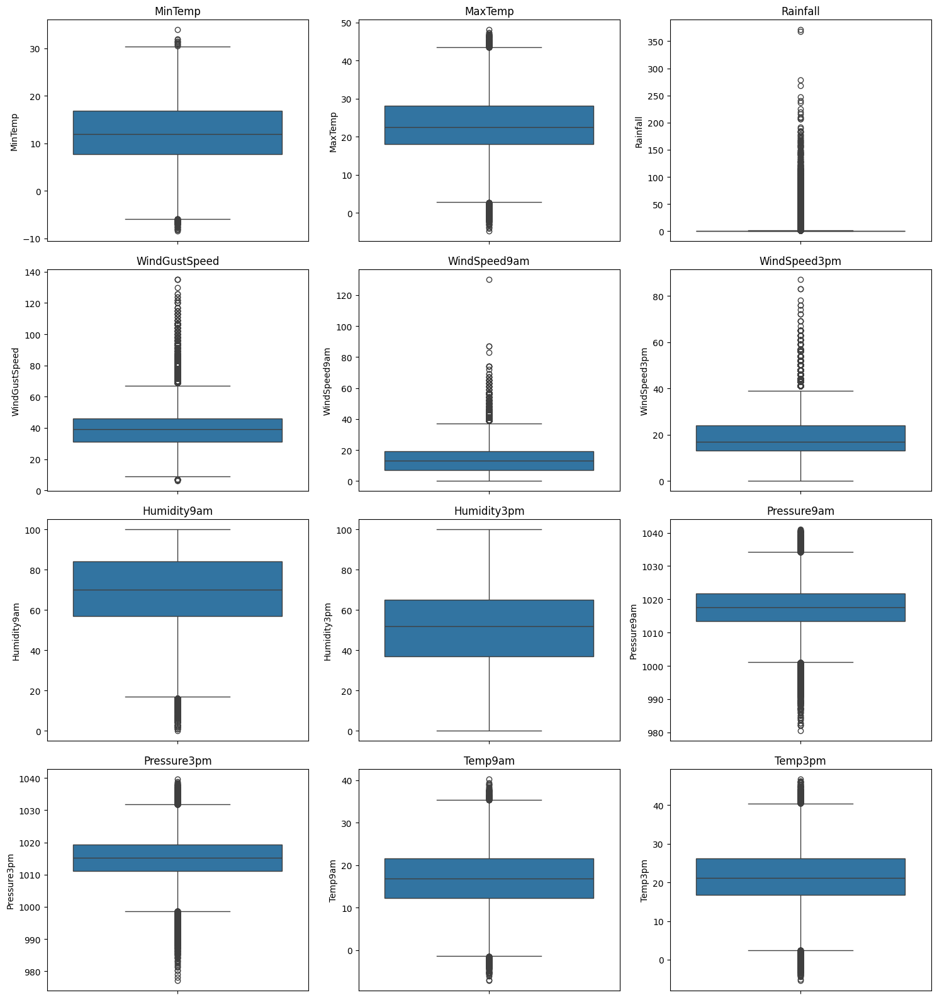

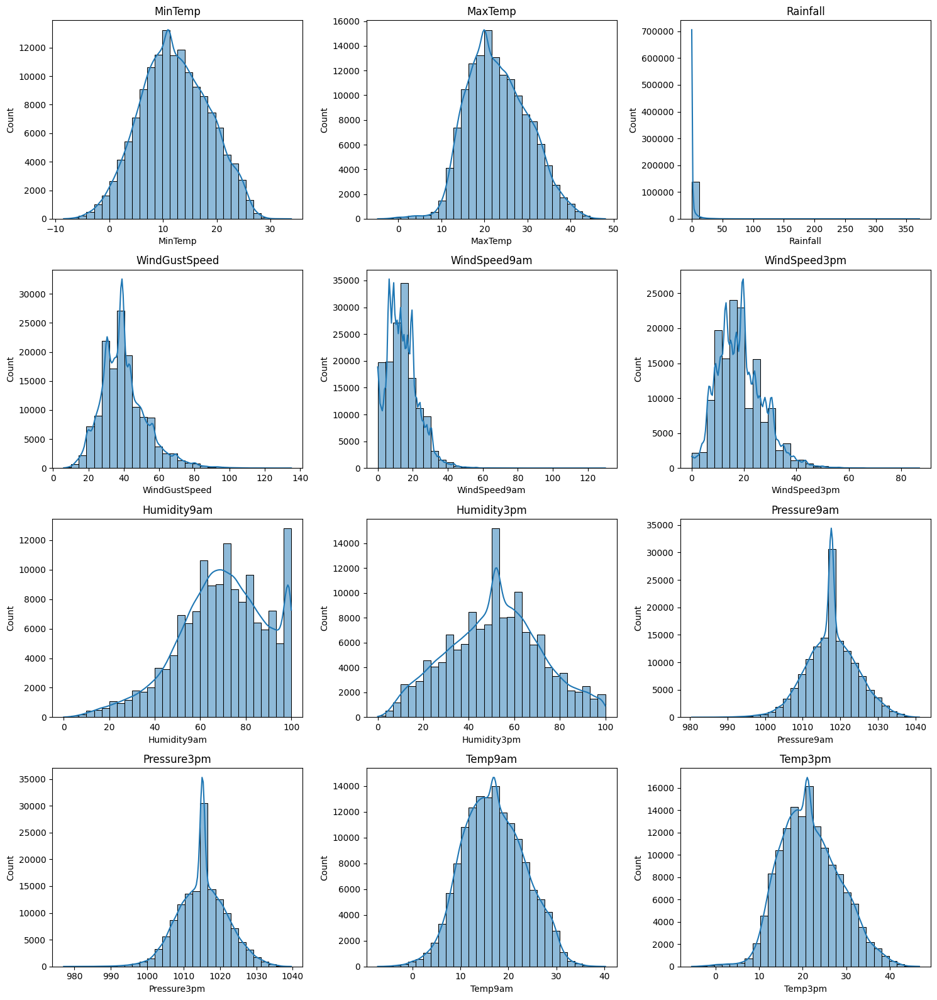

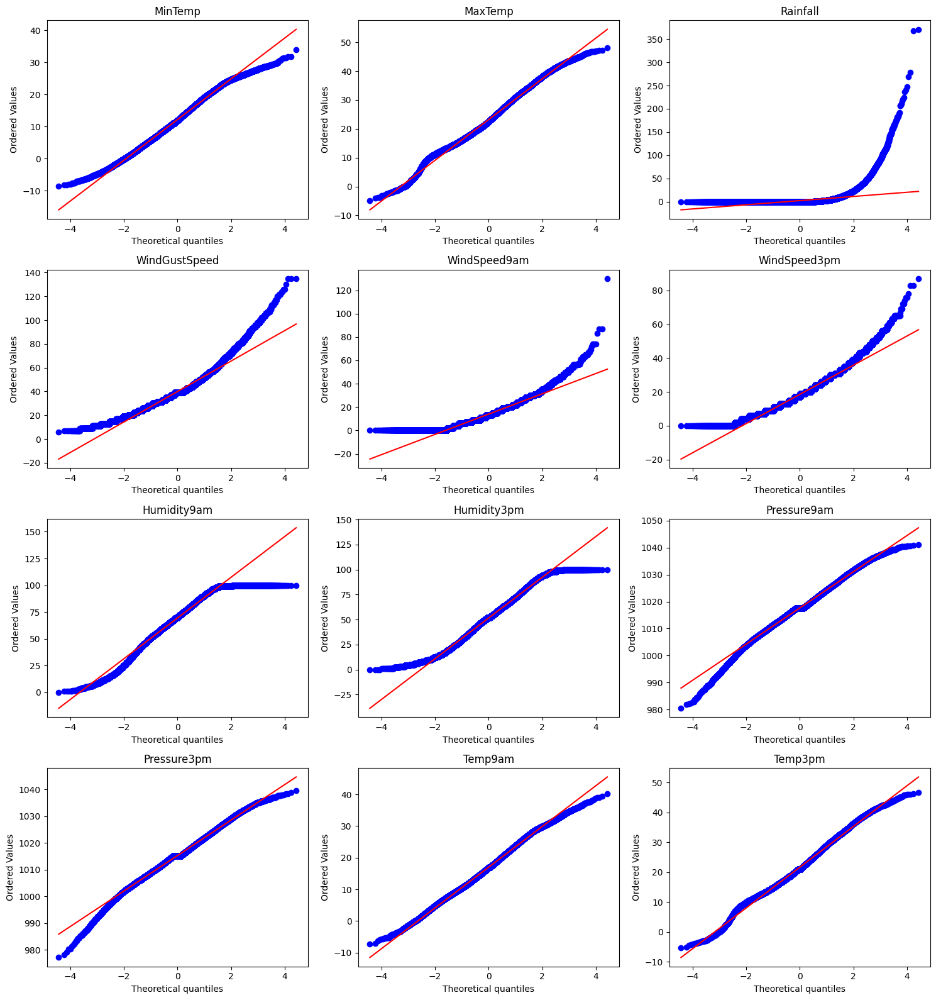

In [22]:
# Define rows and columns
num_plots = len(numerical_cols)
cols = 3
rows = math.ceil(num_plots / cols)

# ---- Boxplot ----
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(15, rows * 4))
axes = axes.flatten()

for i, col in enumerate(numerical_cols):
    sns.boxplot(y=df[col], ax=axes[i])
    axes[i].set_title(col)

for i in range(num_plots, len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.savefig("results/boxplots.png", dpi=300, bbox_inches='tight')
plt.show()


# ---- Histogram + KDE ----
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(15, rows * 4))
axes = axes.flatten()

for i, col in enumerate(numerical_cols):
    sns.histplot(df[col], kde=True, bins=30, ax=axes[i])
    axes[i].set_title(col)

for i in range(num_plots, len(axes)):  # Hide unused subplots
    fig.delaxes(axes[i])

plt.tight_layout()
plt.savefig("results/histplot.png", dpi=300, bbox_inches='tight')
plt.show()


# ---- Q-Q Plot ----
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(15, rows * 4))
axes = axes.flatten()

for i, col in enumerate(numerical_cols):
    stats.probplot(df[col].dropna(), dist="norm", plot=axes[i])
    axes[i].set_title(col)

for i in range(num_plots, len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.savefig("results/qqplot.png", dpi=300, bbox_inches='tight')
plt.show()

In [23]:
# Removing outiers which do not affect much
for col in numerical_cols:
   if col not in ["Rainfall", "WindGustSpeed"]:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df = df[(df[col] >= lower_bound) & (df[col] <= upper_bound)]

In [24]:
# Apply Winsorization for WindGustSpeed -> some affect
df["WindGustSpeed"] = np.clip(df["WindGustSpeed"], df["WindGustSpeed"].quantile(0.05), df["WindGustSpeed"].quantile(0.95))

In [25]:
# Apply Log(1+x) Transformation for Rainfall -> too much affect
df["Rainfall"] = np.log1p(df["Rainfall"])

## Standardize categorical values

Standardizing categorical values ensures consistency and accuracy in the dataset, preventing errors due to formatting inconsistencies.

1. **Date Formatting**  
   - The `Date` column was converted from `DD-MM-YYYY` to `YYYY-MM-DD` format using `pd.to_datetime()` for consistency and easier processing.  

2. **Location Standardization**  
   - Location names were formatted for better readability by adding spaces between concatenated words (e.g., `GoldCoast → Gold Coast`).  

3. **Wind Direction Consistency**  
   - The columns `WindGustDir`, `WindDir9am`, and `WindDir3pm` were standardized to ensure all values are uppercase and free of extra spaces.  
  

In [26]:
# Checking for standardization
for col in categorical_cols:
    print(f"{col} Unique Values:\n", df[col].unique(), "\n")

Date Unique Values:
 ['01-12-2008' '02-12-2008' '03-12-2008' ... '04-09-2008' '21-11-2008'
 '22-11-2008'] 

Location Unique Values:
 ['Albury' 'BadgerysCreek' 'Cobar' 'CoffsHarbour' 'Moree' 'Newcastle'
 'NorahHead' 'NorfolkIsland' 'Penrith' 'Richmond' 'Sydney' 'SydneyAirport'
 'WaggaWagga' 'Williamtown' 'Wollongong' 'Canberra' 'Tuggeranong'
 'MountGinini' 'Ballarat' 'Bendigo' 'Sale' 'MelbourneAirport' 'Melbourne'
 'Mildura' 'Nhil' 'Portland' 'Watsonia' 'Dartmoor' 'Brisbane' 'Cairns'
 'GoldCoast' 'Townsville' 'Adelaide' 'MountGambier' 'Nuriootpa' 'Woomera'
 'Albany' 'Witchcliffe' 'PearceRAAF' 'PerthAirport' 'Perth' 'SalmonGums'
 'Walpole' 'Hobart' 'Launceston' 'AliceSprings' 'Darwin' 'Katherine'
 'Uluru'] 

WindGustDir Unique Values:
 ['W' 'WNW' 'WSW' 'NE' 'NNW' 'N' 'NNE' 'ENE' 'SSE' 'S' 'SW' 'SE' 'NW' 'E'
 'SSW' 'ESE'] 

WindDir9am Unique Values:
 ['W' 'NNW' 'SE' 'ENE' 'SW' 'SSE' 'S' 'NE' 'N' 'SSW' 'WSW' 'ESE' 'E' 'NW'
 'WNW' 'NNE'] 

WindDir3pm Unique Values:
 ['WNW' 'WSW' 'E' 'NW' 'W

In [27]:
# Date -> YYYY-MM-DD DateTime format
df['Date'] = pd.to_datetime(df['Date'], format='%d-%m-%Y')

In [28]:
# Ensuring Consistency in Winds
wind_cols = ['WindGustDir', 'WindDir9am', 'WindDir3pm']
df[wind_cols] = df[wind_cols].apply(lambda x: x.str.upper().str.strip())

In [29]:
# Changing Camel Case to Title Case
df['Location'] = df['Location'].str.replace(r'(?<!^)(?=[A-Z])', ' ', regex=True)

In [30]:
for col in categorical_cols:
    print(f"{col} Unique Values:\n", df[col].unique(), "\n")

Date Unique Values:
 <DatetimeArray>
['2008-12-01 00:00:00', '2008-12-02 00:00:00', '2008-12-03 00:00:00',
 '2008-12-04 00:00:00', '2008-12-05 00:00:00', '2008-12-06 00:00:00',
 '2008-12-07 00:00:00', '2008-12-08 00:00:00', '2008-12-09 00:00:00',
 '2008-12-10 00:00:00',
 ...
 '2008-01-30 00:00:00', '2008-01-31 00:00:00', '2008-07-01 00:00:00',
 '2008-09-16 00:00:00', '2008-11-20 00:00:00', '2008-11-23 00:00:00',
 '2008-09-03 00:00:00', '2008-09-04 00:00:00', '2008-11-21 00:00:00',
 '2008-11-22 00:00:00']
Length: 3431, dtype: datetime64[ns] 

Location Unique Values:
 ['Albury' 'Badgerys Creek' 'Cobar' 'Coffs Harbour' 'Moree' 'Newcastle'
 'Norah Head' 'Norfolk Island' 'Penrith' 'Richmond' 'Sydney'
 'Sydney Airport' 'Wagga Wagga' 'Williamtown' 'Wollongong' 'Canberra'
 'Tuggeranong' 'Mount Ginini' 'Ballarat' 'Bendigo' 'Sale'
 'Melbourne Airport' 'Melbourne' 'Mildura' 'Nhil' 'Portland' 'Watsonia'
 'Dartmoor' 'Brisbane' 'Cairns' 'Gold Coast' 'Townsville' 'Adelaide'
 'Mount Gambier' 'Nuriootp

# Exploratory Data Analysis (EDA):

In [31]:
df.shape

(136077, 19)

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 136077 entries, 0 to 145459
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Date           136077 non-null  datetime64[ns]
 1   Location       136077 non-null  object        
 2   MinTemp        136077 non-null  float64       
 3   MaxTemp        136077 non-null  float64       
 4   Rainfall       136077 non-null  float64       
 5   WindGustDir    136077 non-null  object        
 6   WindGustSpeed  136077 non-null  float64       
 7   WindDir9am     136077 non-null  object        
 8   WindDir3pm     136077 non-null  object        
 9   WindSpeed9am   136077 non-null  float64       
 10  WindSpeed3pm   136077 non-null  float64       
 11  Humidity9am    136077 non-null  float64       
 12  Humidity3pm    136077 non-null  float64       
 13  Pressure9am    136077 non-null  float64       
 14  Pressure3pm    136077 non-null  float64       
 15  Temp9

In [33]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.470004,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.000000,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.000000,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.000000,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,0.693147,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,No


In [34]:
numerical_cols = df.select_dtypes(include=['number']).columns.tolist()
categorical_cols = df.select_dtypes(include=['object']).columns.tolist()
numerical_cols, categorical_cols

(['MinTemp',
  'MaxTemp',
  'Rainfall',
  'WindGustSpeed',
  'WindSpeed9am',
  'WindSpeed3pm',
  'Humidity9am',
  'Humidity3pm',
  'Pressure9am',
  'Pressure3pm',
  'Temp9am',
  'Temp3pm'],
 ['Location',
  'WindGustDir',
  'WindDir9am',
  'WindDir3pm',
  'RainToday',
  'RainTomorrow'])

## **Univariate Analysis**

Univariate analysis helped us understand the **distribution and characteristics** of individual features in the dataset.

### **Numerical Variables**  
- **Histograms** revealed the **spread and skewness** of numerical features, highlighting potential **outliers and trends**.  
- **Box plots** provided insights into **median, quartiles, and presence of extreme values**.  

### **Categorical Variables**  
- **Bar plots** illustrated the **frequency distribution** of each category, making it easy to spot dominant values.  
- **Pie charts** visualized the **proportion of categories**, helping us understand class imbalances.  


In [35]:
# Statistical summary
df.describe()

,Date,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm
count,136077,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000,136077.000000
mean,2013-04-06 02:39:02.432593408,12.213403,23.257570,0.460337,38.566282,13.364441,17.931149,69.873226,51.597640,1017.899120,1015.480856,17.006260,21.742609
min,2007-11-01 00:00:00,-5.900000,2.800000,0.000000,20.000000,0.000000,0.000000,17.000000,1.000000,1001.700000,999.400000,-1.200000,2.800000
25%,2011-01-11 00:00:00,7.700000,18.200000,0.000000,31.000000,7.000000,13.000000,58.000000,37.000000,1013.900000,1011.500000,12.500000,16.900000
50%,2013-05-31 00:00:00,11.900000,22.700000,0.000000,39.000000,13.000000,17.000000,70.000000,52.000000,1017.600000,1015.200000,16.800000,21.100000
75%,2015-06-17 00:00:00,16.800000,28.100000,0.470004,46.000000,19.000000,24.000000,84.000000,65.000000,1021.800000,1019.400000,21.400000,26.200000
max,2017-06-25 00:00:00,30.200000,43.500000,5.918894,59.000000,37.000000,39.000000,100.000000,100.000000,1034.000000,1031.400000,35.100000,40.400000
std,NaN,6.273310,6.778499,0.880214,10.440494,8.070966,7.921813,18.446762,19.933771,6.064927,6.034867,6.239144,6.536863


In [36]:
# Skewness for numerical data
df[numerical_cols].skew()

MinTemp          0.056733
MaxTemp          0.248912
Rainfall         2.117870
WindGustSpeed    0.233441
WindSpeed9am     0.426268
WindSpeed3pm     0.288909
Humidity9am     -0.346540
Humidity3pm      0.064512
Pressure9am      0.061385
Pressure3pm      0.073329
Temp9am          0.099714
Temp3pm          0.258246
dtype: float64

In [37]:
# Kurtosis for numerical data
df[numerical_cols].kurtosis()

MinTemp         -0.506947
MaxTemp         -0.480840
Rainfall         3.880598
WindGustSpeed   -0.616947
WindSpeed9am    -0.311126
WindSpeed3pm    -0.382913
Humidity9am     -0.352690
Humidity3pm     -0.430372
Pressure9am     -0.174552
Pressure3pm     -0.225421
Temp9am         -0.452975
Temp3pm         -0.360110
dtype: float64

In [38]:
# Frequency distribution of categorical data
for col in categorical_cols:
    print(f"Counts for {col}:")
    print(df[col].value_counts())
    print(f"Percentage distribution for {col}:")
    print(df[col].value_counts(normalize=True) * 100)

Counts for Location:
Location
Canberra             3251
Sydney               3223
Brisbane             3181
Darwin               3158
Perth                3141
Penrith              3011
Adelaide             3000
Cairns               2987
Townsville           2986
Salmon Gums          2952
Moree                2951
Newcastle            2948
Witchcliffe          2938
Norfolk Island       2922
Tuggeranong          2920
Albury               2918
Walpole              2916
Badgerys Creek       2910
Richmond             2900
Pearce R A A F       2896
Coffs Harbour        2896
Bendigo              2896
Perth Airport        2895
Wagga Wagga          2880
Cobar                2877
Watsonia             2852
Mildura              2844
Launceston           2825
Dartmoor             2812
Albany               2811
Williamtown          2806
Nuriootpa            2801
Mount Gambier        2799
Gold Coast           2769
Melbourne            2751
Portland             2739
Ballarat             2734
Norah He

<Figure size 1200x1000 with 0 Axes>

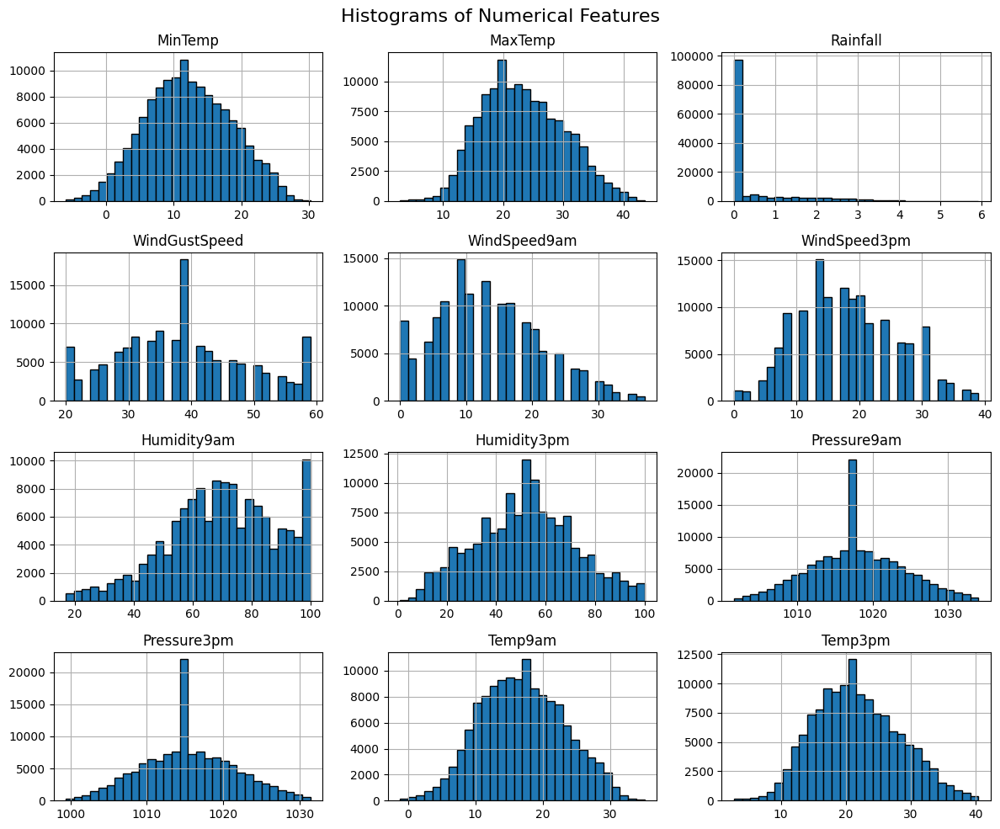

In [39]:
# Histograms for numerical variables
plt.figure(figsize=(12, 10))
df[numerical_cols].hist(figsize=(12, 10), bins=30, edgecolor="black")
plt.suptitle("Histograms of Numerical Features", fontsize=16)
plt.tight_layout()
plt.savefig("results/univariate-histograms.png", dpi=300, bbox_inches="tight")
plt.show()

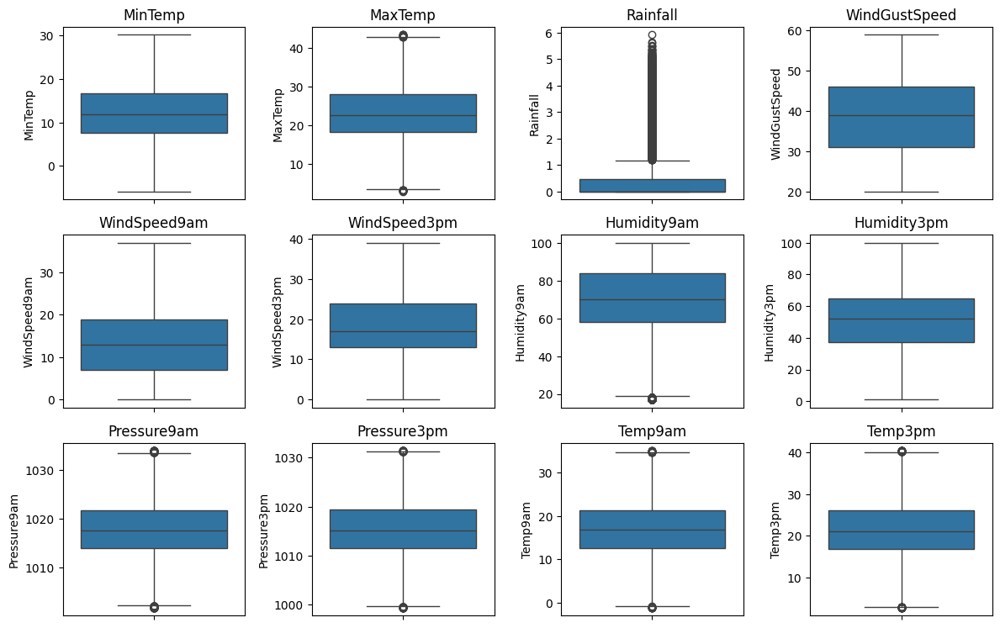

In [40]:
# Boxplots for numerical variables
plt.figure(figsize=(12, 10))
for i, col in enumerate(numerical_cols, 1):
    plt.subplot((len(numerical_cols) // 4) + 1, 4, i)
    sns.boxplot(y=df[col])
    plt.title(col)
plt.tight_layout()
plt.savefig("results/univariate-boxplots.png", dpi=300, bbox_inches="tight")
plt.show()

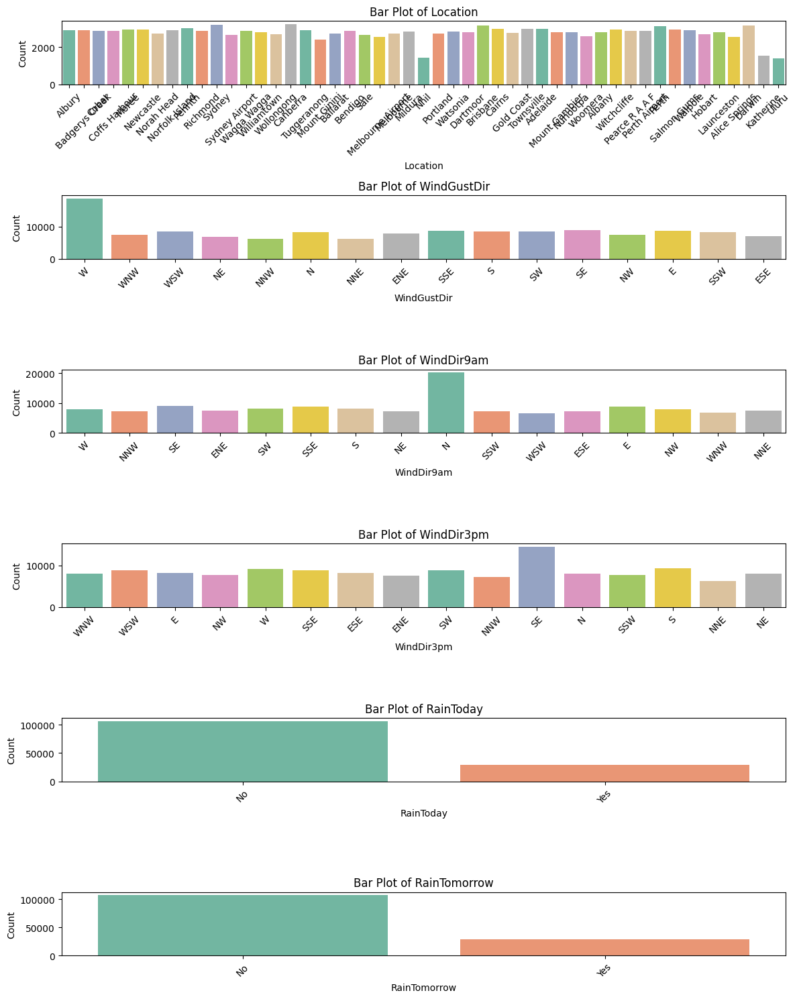

In [41]:
# Barplot for categorical variables
plt.figure(figsize=(12, 15))
for i, col in enumerate(categorical_cols, 1):
    plt.subplot(len(categorical_cols), 1, i)
    sns.countplot(x=df[col], data=df, hue=col, legend=False, palette="Set2")
    plt.xticks(rotation=45)
    plt.title(f"Bar Plot of {col}")
    plt.xlabel(col)
    plt.ylabel("Count")
plt.tight_layout()
plt.savefig("results/univariate-barplots.png", dpi=300, bbox_inches="tight")
plt.show()

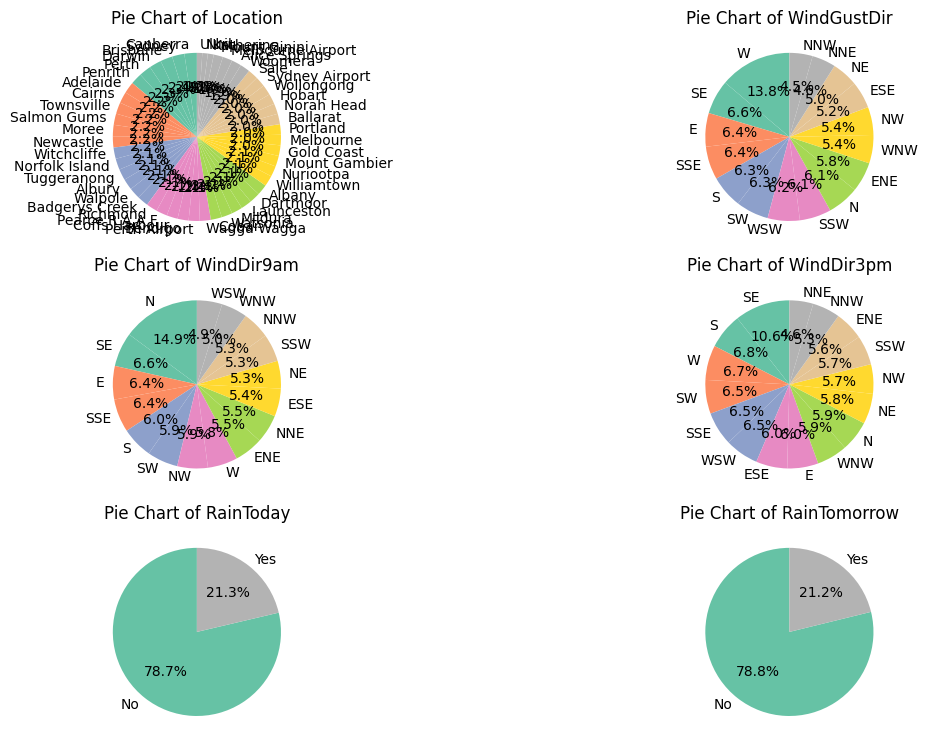

In [42]:
# Piechart for categorical variables
plt.figure(figsize=(12, 15))

for i, col in enumerate(categorical_cols, 1):
    if col in df.columns:
        plt.subplot(len(categorical_cols), 2, i)  # Arrange in two columns for better layout
        df[col].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, cmap="Set2")
        plt.ylabel("")
        plt.title(f"Pie Chart of {col}")

plt.tight_layout()
plt.savefig("results/univariate-piecharts.png", dpi=300, bbox_inches="tight")
plt.show()

### **Bivariate Analysis**  
Bivariate analysis helped us explore relationships between pairs of variables, identifying trends, correlations, and category-based distributions.  

#### **Numerical-Numerical Relationships**  
1. **Correlation Matrix** revealed the strength and direction of relationships between numerical variables, identifying strong positive and negative correlations.  
2. **Scatter Plots** visualized these relationships, highlighting patterns, trends, and potential nonlinear dependencies.  

#### **Numerical-Categorical Relationships**  
1. **Box Plots** displayed the distribution of numerical variables across categories, revealing median differences and the presence of outliers.  
2. **Violin Plots** provided additional insights into distribution density, showing variations within each category.  
3. **Bar Plots** highlighted the mean values of numerical variables for each category, making it easier to compare trends across groups.  


#### **Categorical-Categorical Relationships**  
1. **Stacked Bar Plots** illustrated the proportional distribution of one categorical variable across different categories of another, making it easy to identify dominant categories and trends.
2. **Crosstab Heatmaps** provided a detailed view of category interactions, highlighting the frequency of occurrences between pairs of categorical variables and revealing potential correlations or dependencies.  

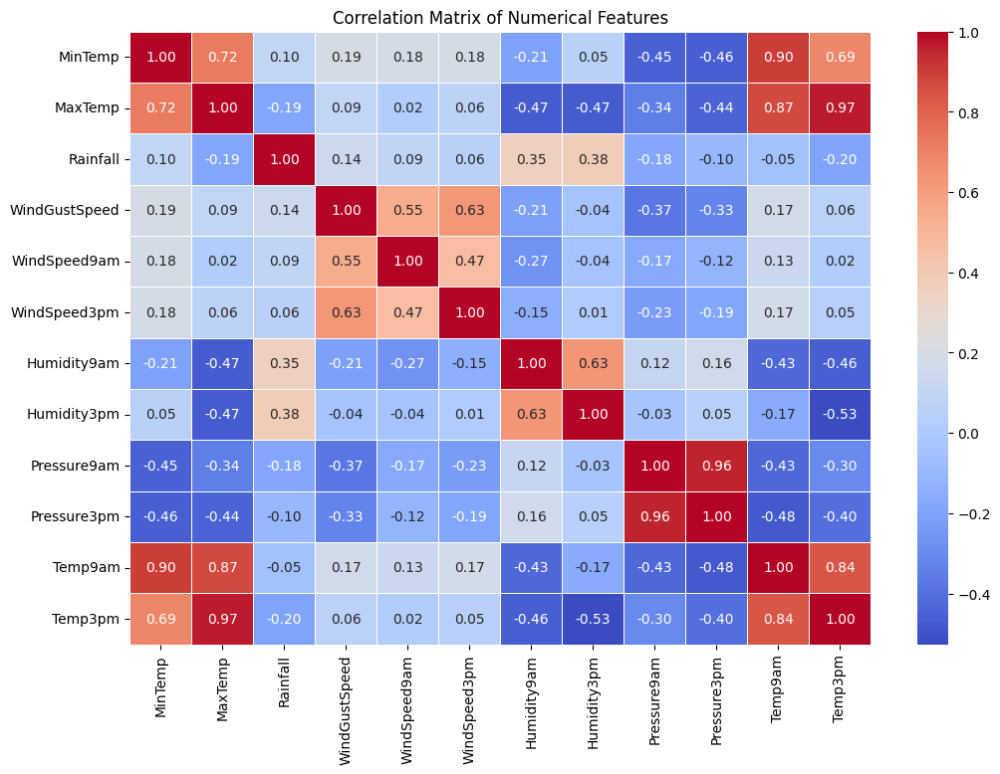

In [43]:
# Correlation Matrix for Numerical Variables
correlation_matrix = df[numerical_cols].corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Numerical Features")
plt.savefig("results/bivariate-correlation-matrix.png", dpi=300, bbox_inches="tight")
plt.show()

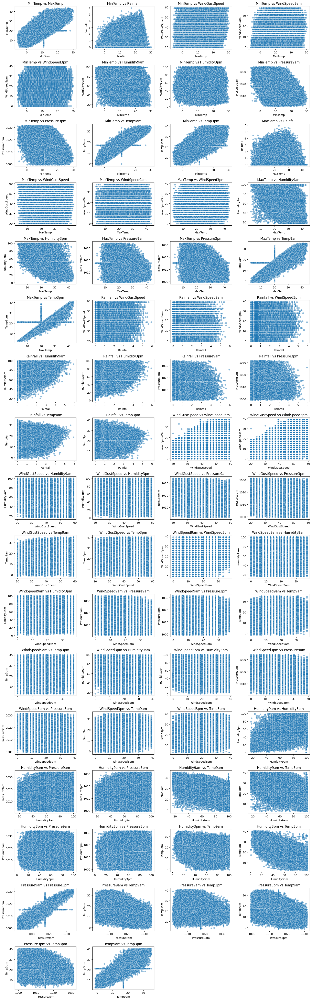

In [44]:
# Scatter Plot for Continuous Variable Relationship
num_pairs = list(itertools.combinations(numerical_cols, 2))

# Determine grid size
num_plots = len(num_pairs)
cols = 4  # Adjust for better layout
rows = math.ceil(num_plots / cols)

# Create scatter plots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 3))
for ax, (x_col, y_col) in zip(axes.flatten(), num_pairs):
    sns.scatterplot(data=df, x=x_col, y=y_col, alpha=0.5, ax=ax)
    ax.set_title(f"{x_col} vs {y_col}")

for i in range(len(num_pairs), rows * cols):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()
plt.savefig("results/bivariate-scatter-plots.png", dpi=300, bbox_inches="tight")
plt.show()

<Figure size 2000x2000 with 0 Axes>

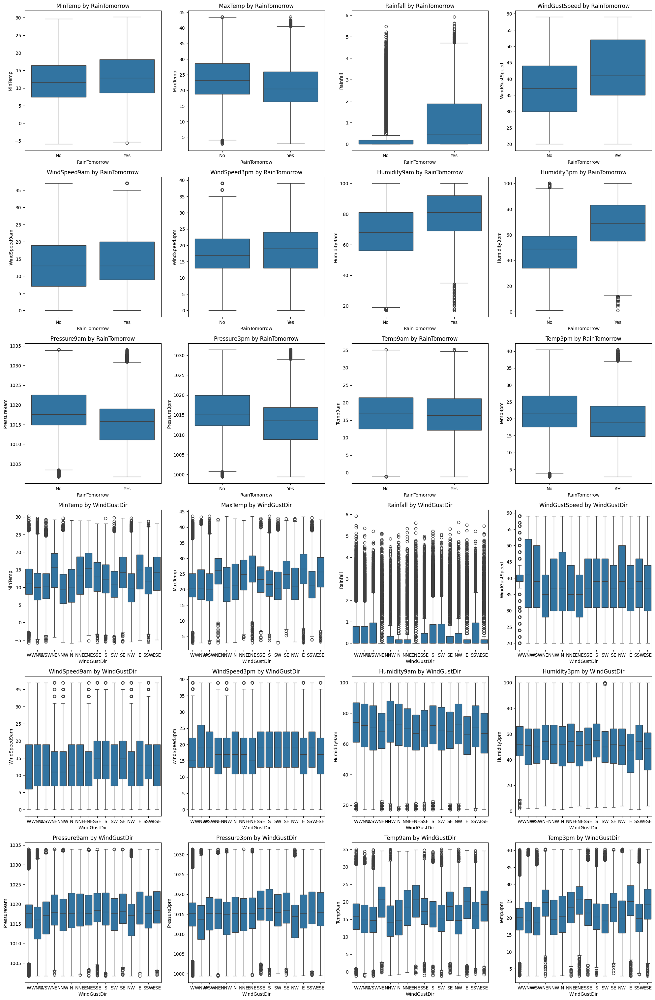

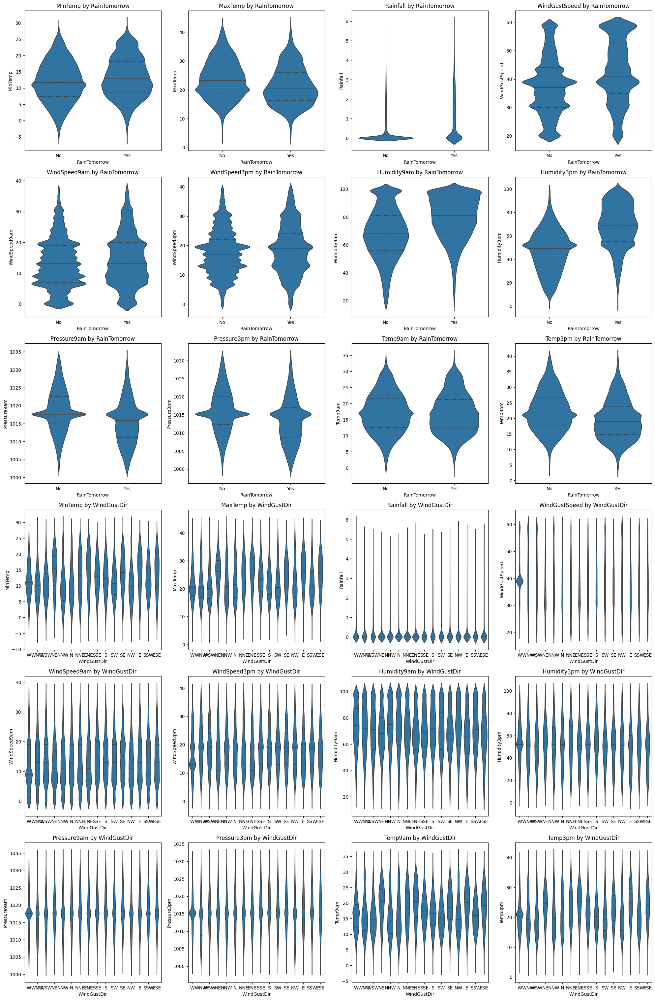

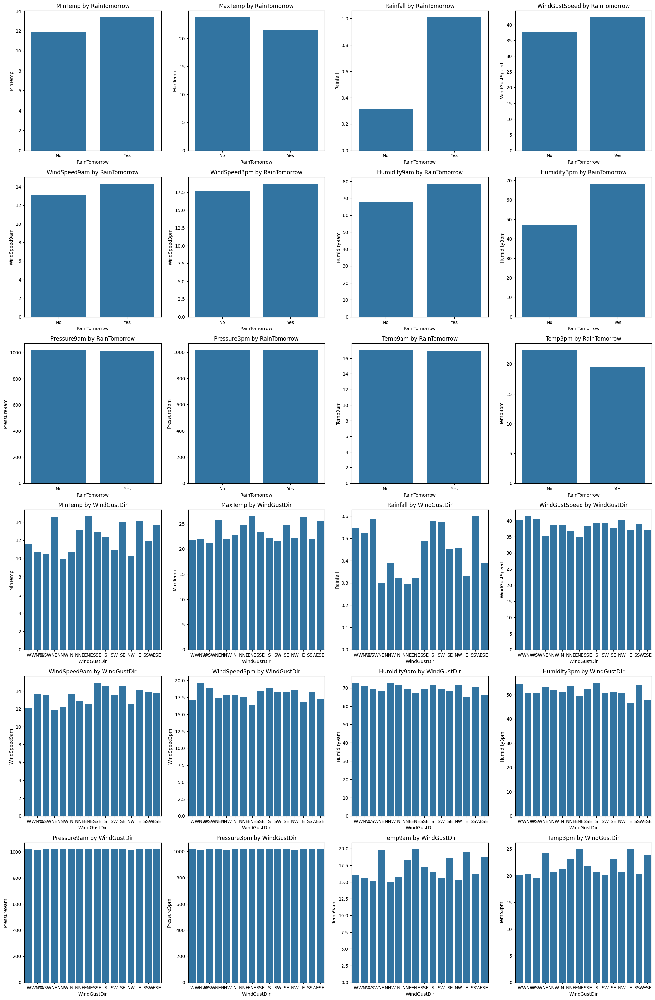

In [45]:
# Numerical-Categorical comparison
plt.figure(figsize=(20, 20))

categorical_cols_subset = ["RainTomorrow", "WindGustDir"]  # Key categorical variables

# Determine grid size
num_cats = len(categorical_cols_subset)
num_nums = len(numerical_cols)
total_plots = num_cats * num_nums

rows = (total_plots // 4) + 1  # Adjust rows dynamically
cols = min(4, total_plots)  # Keep a max of 4 columns per row

# Box plots
plt.figure(figsize=(20, rows * 5))  # Increase height based on the number of rows

plot_idx = 1
for cat_col in categorical_cols_subset:
    for num_col in numerical_cols:
        plt.subplot(rows, cols, plot_idx)
        sns.boxplot(data=df, x=cat_col, y=num_col)
        plt.title(f"{num_col} by {cat_col}")
        plot_idx += 1

plt.tight_layout()
plt.savefig("results/bivariate_boxplots.png", dpi=300, bbox_inches="tight")
plt.show()

# Violin plots
plt.figure(figsize=(20, rows * 5))

plot_idx = 1
for cat_col in categorical_cols_subset:
    for num_col in numerical_cols:
        plt.subplot(rows, cols, plot_idx)
        sns.violinplot(data=df, x=cat_col, y=num_col, inner="quartile")
        plt.title(f"{num_col} by {cat_col}")
        plot_idx += 1

plt.tight_layout()
plt.savefig("results/bivariate_violinplots.png", dpi=300, bbox_inches="tight")
plt.show()

# Bar plots
plt.figure(figsize=(20, rows * 5))

plot_idx = 1
for cat_col in categorical_cols_subset:
    for num_col in numerical_cols:
        plt.subplot(rows, cols, plot_idx)
        sns.barplot(data=df, x=cat_col, y=num_col, errorbar=None)  # Updated for latest seaborn
        plt.title(f"{num_col} by {cat_col}")
        plot_idx += 1

plt.tight_layout()
plt.savefig("results/bivariate_all_barplots.png", dpi=300, bbox_inches="tight")
plt.show()

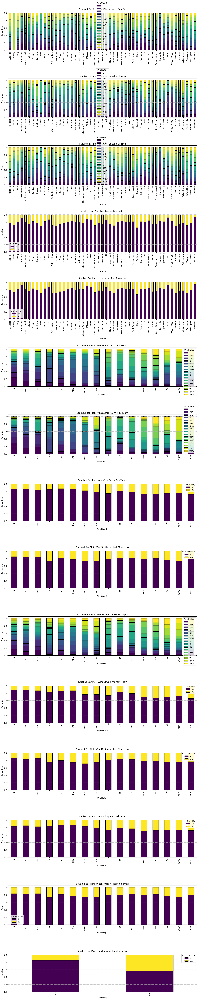

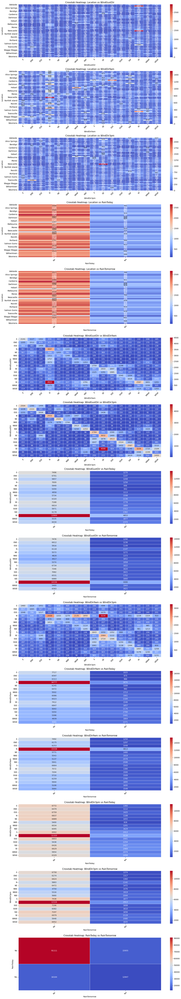

In [46]:
# Categorical-Categorical comparison

# Get all categorical column pairs
cat_pairs = list(itertools.combinations(categorical_cols, 2))

# Stacked Bar Plots
plt.figure(figsize=(15, len(cat_pairs) * 5))
for i, (cat1, cat2) in enumerate(cat_pairs, 1):
    plt.subplot(len(cat_pairs), 1, i)
    cross_tab = pd.crosstab(df[cat1], df[cat2], normalize="index")
    cross_tab.plot(kind="bar", stacked=True, colormap="viridis", edgecolor="black", ax=plt.gca())
    plt.title(f"Stacked Bar Plot: {cat1} vs {cat2}")
    plt.ylabel("Proportion")
    plt.xlabel(cat1)
    plt.legend(title=cat2)
    plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.tight_layout()
plt.savefig("results/stacked-barplots-categorical.png", dpi=300, bbox_inches="tight")
plt.show()


# Crosstab Heatmaps
plt.figure(figsize=(15, len(cat_pairs) * 5))
for i, (cat1, cat2) in enumerate(cat_pairs, 1):
    plt.subplot(len(cat_pairs), 1, i)
    cross_tab = pd.crosstab(df[cat1], df[cat2])
    sns.heatmap(cross_tab, cmap="coolwarm", annot=True, fmt="d", linewidths=0.5)
    plt.title(f"Crosstab Heatmap: {cat1} vs {cat2}")
    plt.ylabel(cat1)
    plt.xlabel(cat2)
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)

plt.tight_layout()
plt.savefig("results/crosstab-heatmaps-categorical.png", dpi=300, bbox_inches="tight")
plt.show()

# Multivariate Analysis

Multivariate analysis examines relationships between multiple variables simultaneously, helping to uncover patterns, correlations, and dependencies. In this analysis, we use **pair plots** to visualize pairwise relationships among numerical features, making it easier to detect trends, clusters, and potential outliers.

## Key Insights from the Pair Plot:

1. **Correlations:** Variables with strong linear relationships can be identified based on aligned data points.  
2. **Distributions:** The diagonal plots (kde/histograms) reveal the individual distributions of each feature.  
3. **Clusters & Outliers:** Patterns in scatter plots may indicate natural groupings or anomalies in the data.  
4. **Feature Interactions:** Helps determine which variables influence each other, aiding in feature selection.  


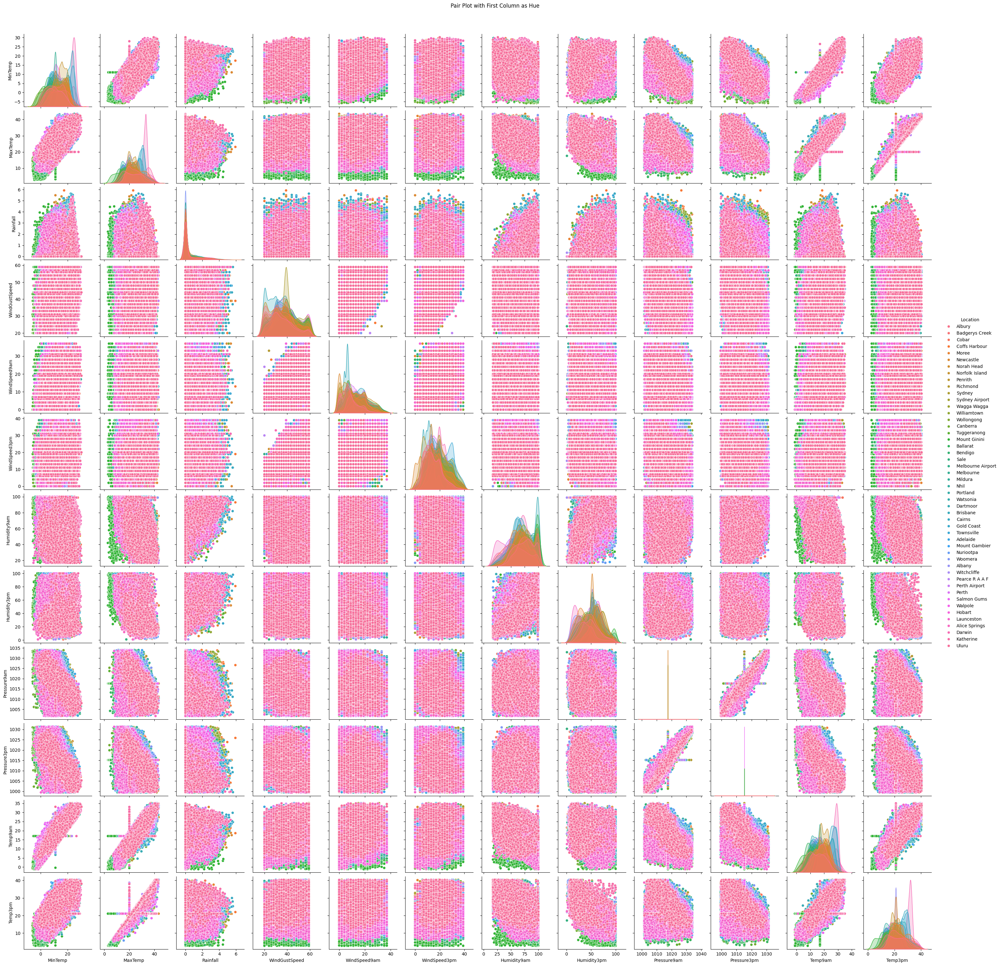

In [48]:
# Pairwise relationship in dataset
sns.pairplot(df, hue='Location')  # Assuming the first column is categorical
plt.suptitle('Pair Plot with First Column as Hue', y=1.02)
plt.savefig('results/multivariate_pair_plot.png')

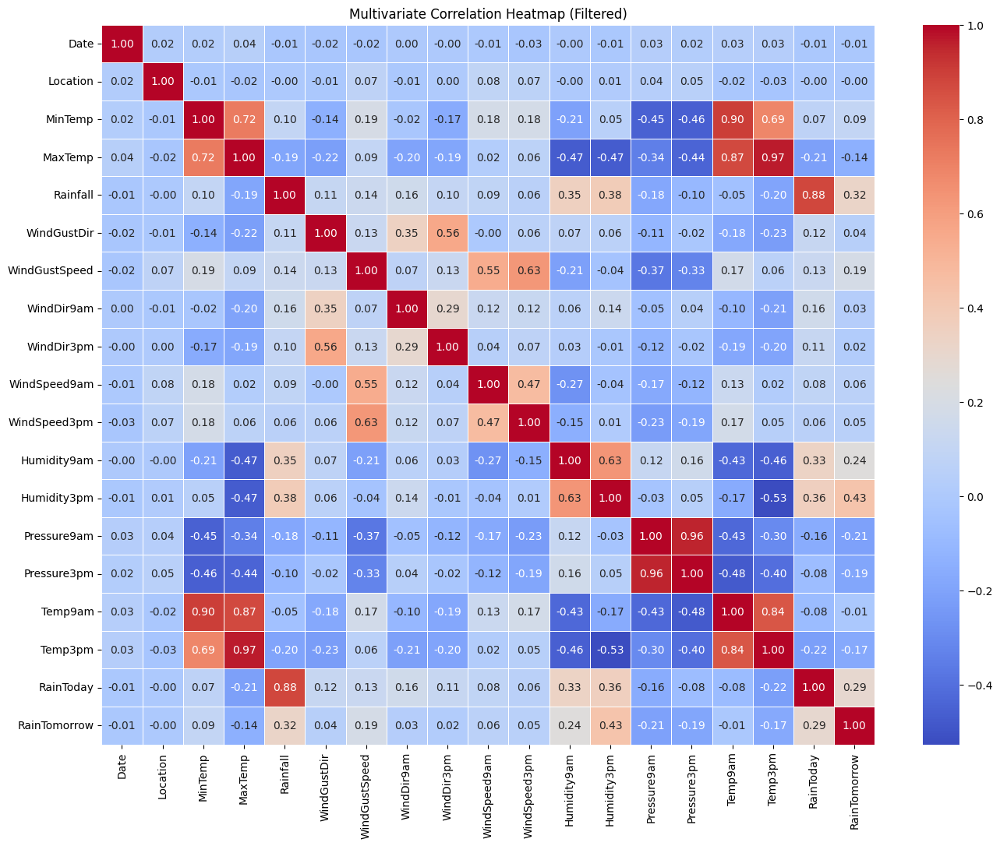

In [49]:
# Correlation Heatmap including both Numerical and Categorical

# Convert categorical variables to numerical (Label Encoding for high-cardinality variables)
df_encoded = df.copy()
for col in df_encoded.select_dtypes(include=['object', 'category']).columns:
    df_encoded[col] = df_encoded[col].astype("category").cat.codes

# Compute correlation matrix on the transformed dataset
correlation_matrix = df_encoded.corr()


# Plot Heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title("Multivariate Correlation Heatmap (Filtered)")
plt.savefig("results/multivariate-heatmap.png", dpi=300, bbox_inches="tight")
plt.show()